In [ ]:
!pip install easyocr
!pip install img2table
!pip install img2table[easyocr]
!pip install pytesseract

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 34.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 813.9/813.9 kB 55.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 146.0/146.0 kB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.6/82.6 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 23.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.0/153.0 kB 14.7 MB/s eta 0:00:00
  Attempting uninstall: polars
    Found existing installation: polars 0.17.3
    Uninstalling polars-0.17.3:
      Successfully uninstalled polars-0.17.3


In [ ]:
import pandas as pd
import numpy as np
import cv2 as cv
import PIL

from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt
from PIL import Image, ImageFilter

import easyocr
import pytesseract

from img2table.ocr import TesseractOCR
from img2table.document import Image
from img2table.ocr import EasyOCR

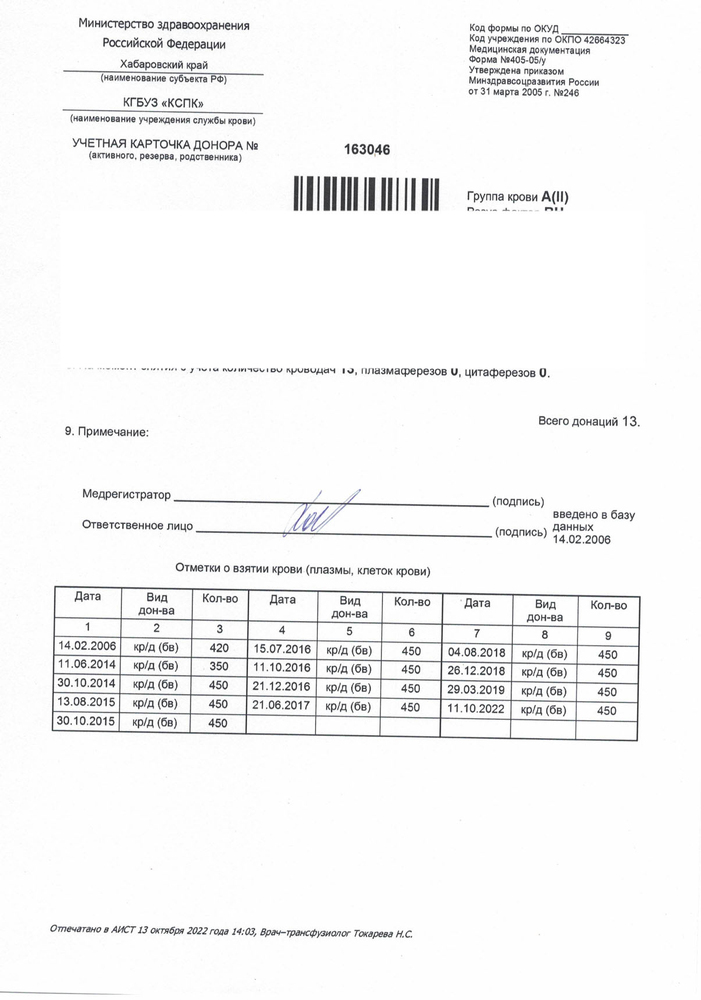

,ID,ID пользователя,Класс крови,Дата донации,Дата добавления донации,Тип донации,Регион,Место стадчи,Статус донации,Есть справка
0,159091,231820,Цельная кровь,14.02.2006,21.11.2022,Безвозмездно,"Россия, Хабаровский край, Хабаровск",567,Принята,Да
1,159093,231820,Цельная кровь,11.06.2014,21.11.2022,Безвозмездно,"Россия, Хабаровский край, Хабаровск",567,Принята,Да
2,159094,231820,Цельная кровь,30.10.2014,21.11.2022,Безвозмездно,"Россия, Хабаровский край, Хабаровск",567,Принята,Да
3,159095,231820,Цельная кровь,13.08.2015,21.11.2022,Безвозмездно,"Россия, Хабаровский край, Хабаровск",567,Принята,Да
4,159096,231820,Цельная кровь,30.10.2015,21.11.2022,Безвозмездно,"Россия, Хабаровский край, Хабаровск",567,Принята,Да


(13, 10)


In [ ]:
img_1_path = '/content/231820 .jpg'
df_1 = pd.read_csv('/content/231820.csv')

img_1_org  = cv.imread(img_1_path)
cv2_imshow(img_1_org)
display(df_1.head())
print(df_1.shape)

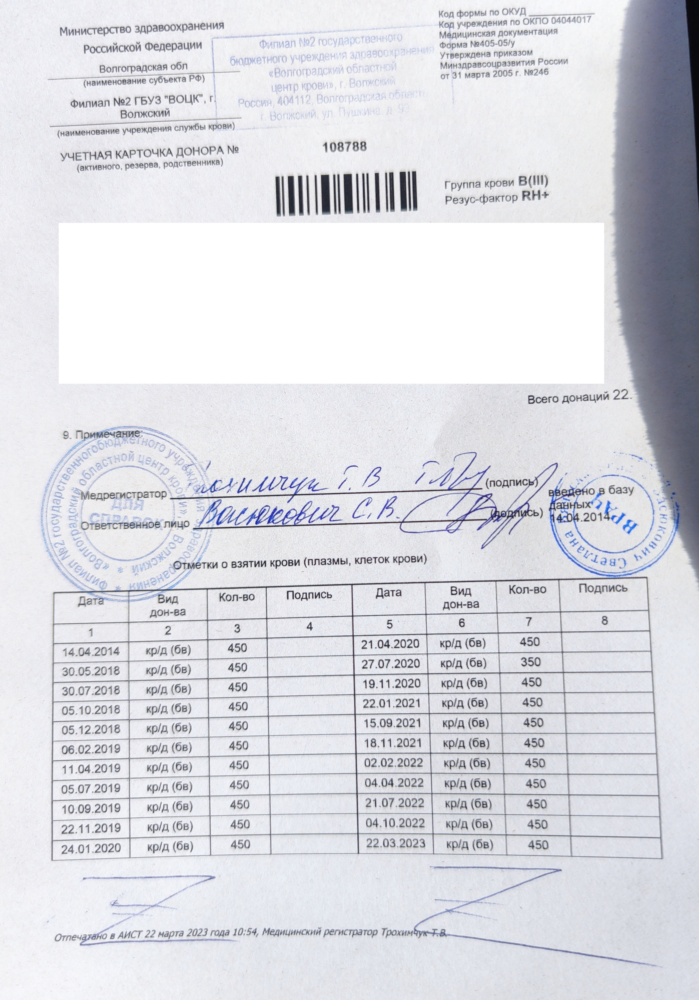

,ID,ID пользователя,Класс крови,Дата донации,Дата добавления донации,Тип донации,Регион,Место стадчи,Статус донации,Есть справка
0,197529,213950,Цельная кровь,2014-04-14,23.03.2023,Безвозмездно,"Россия, Волгоградская область, Волжский",53,Принята,Да
1,197531,213950,Цельная кровь,2018-05-30,23.03.2023,Безвозмездно,"Россия, Волгоградская область, Волжский",53,Принята,Да
2,197532,213950,Цельная кровь,2018-07-30,23.03.2023,Безвозмездно,"Россия, Волгоградская область, Волжский",53,Принята,Да
3,197938,213950,Цельная кровь,2018-10-05,24.03.2023,Безвозмездно,"Россия, Волгоградская область, Волжский",53,Принята,Да
4,197939,213950,Цельная кровь,2018-12-05,24.03.2023,Безвозмездно,"Россия, Волгоградская область, Волжский",53,Принята,Да


(22, 10)


In [ ]:
img_2_path = '/content/213950.jpg'
df_2 = pd.read_csv('/content/213950.csv')
df_2['Дата донации'] = pd.to_datetime(df_2['Дата донации'], format='%d.%m.%Y')

img_2_org  = cv.imread(img_2_path)
cv2_imshow(img_2_org)
display(df_2.head())
print(df_2.shape)

### Предобработка

#### Определение таблицы

In [ ]:
def scaleimg(pic):
    img = cv.imread(pic, cv.IMREAD_GRAYSCALE)
    assert img is not None, "file could not be read, check with os.path.exists()"
    th3 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
    cv.THRESH_BINARY,31,36)
    morph_kernel = np.ones([1,1])
    inverted_image = cv.bitwise_not(th3)
    image = inverted_image
    erode_img = cv.erode(image, kernel= morph_kernel, iterations=5)
    #plt.figure(figsize=(10,15))
    #plt.imshow(erode_img,'gray')
    mask = np.zeros(image.shape[:2], dtype=np.uint8)

    hor = np.array([[1,1,1,1,1,1]])
    vertical_lines_eroded_image = cv.erode(erode_img, hor, iterations=1)
    vertical_lines_eroded_image = cv.dilate(vertical_lines_eroded_image, hor, iterations=1)

    ver = np.array([[1],
                [1],
                [1],
                [1],
                [1],
                [1],
                [1]])
    horizontal_lines_eroded_image = cv.erode(erode_img, ver, iterations=1)
    horizontal_lines_eroded_image = cv.dilate(horizontal_lines_eroded_image, ver, iterations=1)

    combined_image = cv.add(vertical_lines_eroded_image, horizontal_lines_eroded_image)

    kernel = cv.getStructuringElement(cv.MORPH_RECT, (2, 2))
    combined_image_dilated = cv.dilate(combined_image, kernel, iterations=1)

    ret, thresh = cv.threshold(combined_image_dilated, 140, 170, 0)
    cnts = cv.findContours(thresh, cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    cc = []
    for c in cnts:
        area = cv.contourArea(c)
        if area > 5000:
            rect = cv.minAreaRect(c)
            corners = cv.boxPoints(rect)
            corners = np.int0(corners)
            cv.fillPoly(mask, [corners], (255,255,255))

            corners = corners.tolist()
            cc.append(corners)
            for i in range(len(cc)):
                xx = []
                yy = []
                if cc[i][0][0] < (img.shape[1]*3/4):
                    for corner in cc[i]:
                        x, y = corner
                        xx.append(x)
                        yy.append(y)
                        cv.circle(image, (x, y), 5, 255, -1)
                else:
                    pass

                img = cv.imread(pic, cv.IMREAD_GRAYSCALE)

                pt_A = [xx[0], yy[0]]
                pt_B = [xx[1], yy[1]]
                pt_C = [xx[2], yy[2]]
                pt_D = [xx[3], yy[3]]

                width_AD = np.sqrt(((pt_A[0] - pt_D[0]) ** 2) + ((pt_A[1] - pt_D[1]) ** 2))
                width_BC = np.sqrt(((pt_B[0] - pt_C[0]) ** 2) + ((pt_B[1] - pt_C[1]) ** 2))
                maxWidth = max(int(width_AD), int(width_BC))


                height_AB = np.sqrt(((pt_A[0] - pt_B[0]) ** 2) + ((pt_A[1] - pt_B[1]) ** 2))
                height_CD = np.sqrt(((pt_C[0] - pt_D[0]) ** 2) + ((pt_C[1] - pt_D[1]) ** 2))
                maxHeight = max(int(height_AB), int(height_CD))

                input_pts = np.float32([pt_A, pt_B, pt_C, pt_D])
                output_pts = np.float32([[0, 0],
                                            [0, maxHeight - 1],
                                            [maxWidth - 1, maxHeight - 1],
                                            [maxWidth - 1, 0]])

                M = cv.getPerspectiveTransform(input_pts,output_pts)
                out = cv.warpPerspective(img,M,(maxWidth, maxHeight),flags=cv.INTER_LINEAR)


                h = cv.flip(out,1)

                #img = Image.fromarray(h)
                #img = img.filter(ImageFilter.SHARPEN)
                if out.shape[0] < out.shape[1]:
                  h = cv.flip(out,1)
                  image = cv.rotate(h, cv.ROTATE_180)
                else:
                  h = cv.flip(out,0)
                  image = cv.rotate(h, cv.ROTATE_90_CLOCKWISE)


            return image

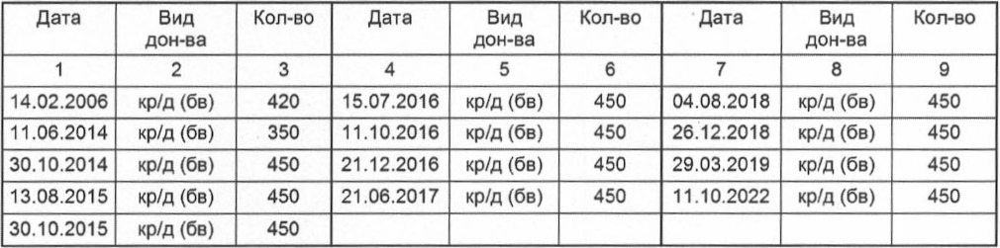

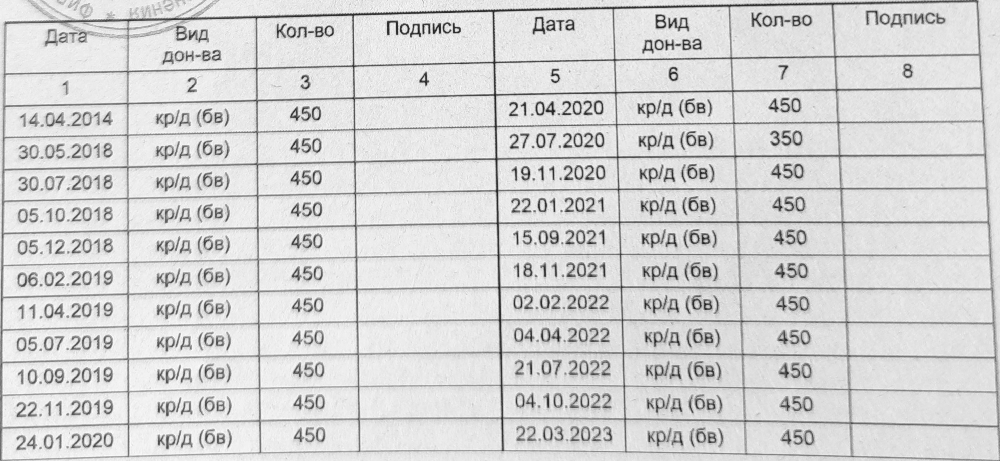

In [ ]:
img_1_sc = scaleimg(img_1_path)
img_2_sc = scaleimg(img_2_path)

cv2_imshow(img_1_sc)
cv2_imshow(img_2_sc)

#### Обработка изображения

In [ ]:
def threshold_image(image):
  #если изображение маленькое, то послеобработки вообще ничего не видно
    #image = cv.threshold(image, 160, 240, cv.THRESH_BINARY)[1] if image.shape[1] > 1000 else image #THRESH_BINARY
    image = image
    return image

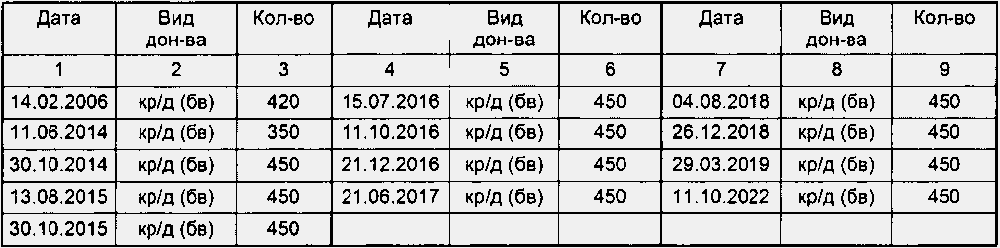

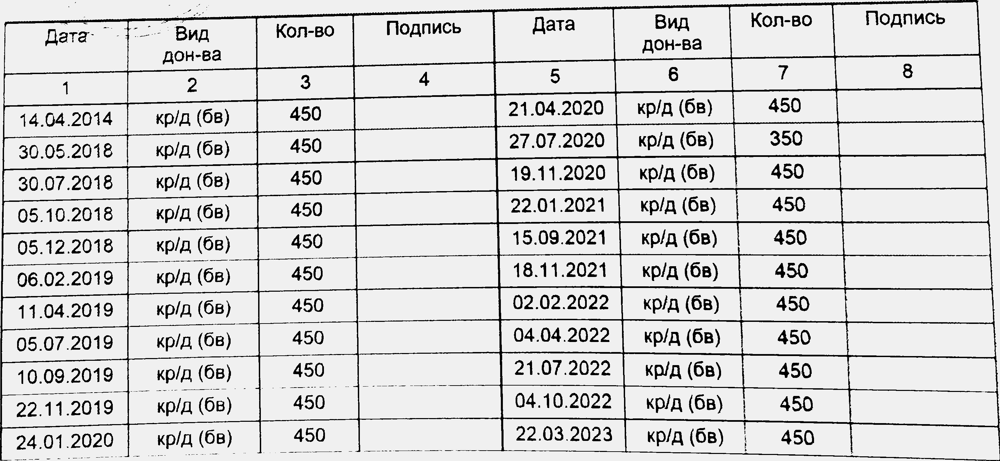

In [ ]:
img_1_th = threshold_image(img_1_sc)
img_2_th = threshold_image(img_2_sc)

cv2_imshow(img_1_th)
cv2_imshow(img_2_th)

In [ ]:
#сохранение изображения
cv.imwrite('/content/213950_th.jpg', img_2_th)

True

### OCR

In [ ]:
reader = easyocr.Reader(['ru'], gpu=True)

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.1% Complete

In [ ]:
result_2 = reader.readtext(img_2_th)

df_result_2 = pd.DataFrame(result_2, columns=['box', 'text', 'coef'])
display(df_result_2.tail(10))
df_result_2.info()

,box,text,coef
72,"[[870, 1167], [977, 1167], [977, 1231], [870, ...",450,1.000000
73,"[[1526, 1160], [1831, 1160], [1831, 1229], [15...",04.10.2022,0.997849
74,"[[1916, 1164], [2163, 1164], [2163, 1244], [19...",крад (бв),0.577020
75,"[[2317, 1172], [2432, 1172], [2432, 1236], [23...",450,0.941291
76,"[[38, 1277], [349, 1277], [349, 1355], [38, 13...",24.01.2020,0.879936
77,"[[459, 1271], [701, 1271], [701, 1348], [459, ...",крад (бв),0.429807
78,"[[870, 1265], [980, 1265], [980, 1326], [870, ...",450,0.548532
79,"[[1531, 1261], [1834, 1261], [1834, 1326], [15...",22.03.2023,0.865868
80,"[[1917, 1267], [2168, 1267], [2168, 1343], [19...",кр/д (бв),0.768632
81,"[[2320, 1272], [2437, 1272], [2437, 1336], [23...",450,0.621452


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82 entries, 0 to 81
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   box     82 non-null     object 
 1   text    82 non-null     object 
 2   coef    82 non-null     float64
dtypes: float64(1), object(2)
memory usage: 2.0+ KB


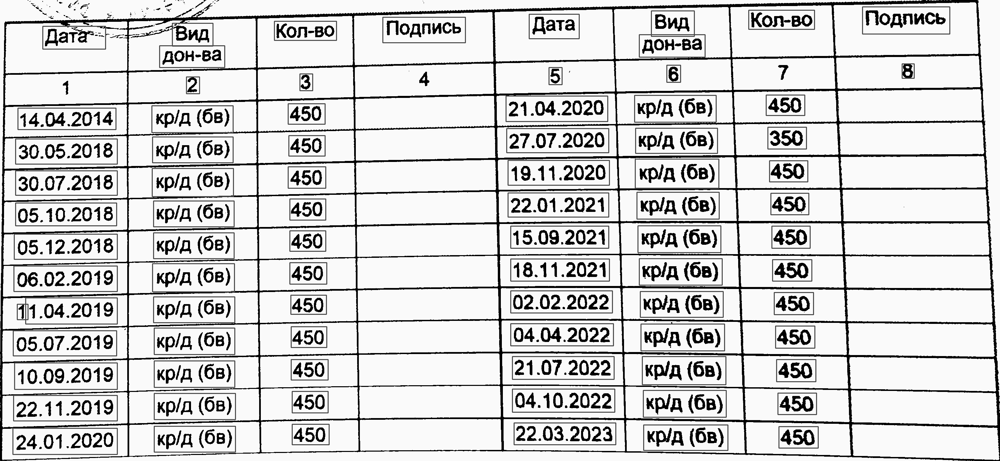

In [ ]:
img_2 = PIL.Image.open('/content/213950_th.jpg')

def  draw_boxes(image, bounds, color='green', width=3):
  draw = PIL.ImageDraw.Draw(image)

  for bound in result_2:
    p0, p1, p2, p3 = bound[0]
    draw.line([*p0,*p1,*p2,*p3, *p0], fill=color, width=width)
  return image.show()

h = draw_boxes(img_2, result_2)

In [ ]:
def create_df(df_result):
  df_new = pd.DataFrame(columns=['Класс крови', 'Дата донации', 'Дата добавления донации', 'Тип донации'])

  for i in range(len(df_result)):
    if df_result['text'][i].lower() in ['пл/д (бв)', 'плад (бв)', 'паф(бв)', 'п/ф(бв)', 'пф(бв)']:
      df_new.loc[len(df_new), ['Дата донации']] = df_result['text'][i-1]
      df_new.loc[len(df_new)-1, ['Класс крови']] = 'Плазма'
      df_new.loc[len(df_new)-1, ['Тип донации']] = 'Безвозмездно'
      df_new.loc[len(df_new)-1, ['Дата добавления донации']] = pd.to_datetime('today', dayfirst=True).normalize()
    elif df_result['text'][i].lower() in ['крад (бв)', 'крод (бв)', 'круд (бв)', 'кр/д (бв)', 'крд (бв)', 'кр/д(бв)',
                                          'с/д бв)" |', 'кред (бв)', 'крд (бв)', 'к/д(бв)', 'хр/д (бв) ф']:
      df_new.loc[len(df_new), ['Дата донации']] = df_result['text'][i-1]
      df_new.loc[len(df_new)-1, ['Класс крови']] = 'Цельная кровь'
      df_new.loc[len(df_new)-1, ['Тип донации']] = 'Безвозмездно'
      df_new.loc[len(df_new)-1, ['Дата добавления донации']] = pd.to_datetime('today', dayfirst=True).normalize()
    elif df_result['text'][i].lower() in ['цд (бв)', 'ц/д (бв)', 'таф(бв)', 'тф(бв)', 'т/ф(бв)']:
      df_new.loc[len(df_new), ['Дата донации']] = df_result['text'][i-1]
      df_new.loc[len(df_new)-1, ['Класс крови']] = 'Тромбоциты'
      df_new.loc[len(df_new)-1, ['Тип донации']] = 'Безвозмездно'
      df_new.loc[len(df_new)-1, ['Дата добавления донации']] = pd.to_datetime('today', dayfirst=True).normalize()
    else:
      pass

  try:
    df_new['Дата донации'] = pd.to_datetime(df_new['Дата донации'], format='%d.%m.%Y', dayfirst=True)
  except:
    pass
  df_new = df_new.sort_values(by='Дата донации').reset_index(drop=True)
  return df_new

In [ ]:
df_2_ocr = create_df(df_result_2)
display(df_2_ocr)

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2014-04-14,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2018-05-30,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2018-07-30,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2018-10-05,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2018-12-05,2023-07-16 00:00:00,Безвозмездно
5,Цельная кровь,2019-02-06,2023-07-16 00:00:00,Безвозмездно
6,Цельная кровь,2019-04-01,2023-07-16 00:00:00,Безвозмездно
7,Цельная кровь,2019-07-05,2023-07-16 00:00:00,Безвозмездно
8,Цельная кровь,2019-09-10,2023-07-16 00:00:00,Безвозмездно
9,Цельная кровь,2019-11-22,2023-07-16 00:00:00,Безвозмездно


#### testing

In [ ]:
def total(img, data):
  img_path = img
  img_sc = scaleimg(img)
  img_th = threshold_image(img_sc)

  result = reader.readtext(img_th)
  df_result = pd.DataFrame(result, columns=['box', 'text', 'coef'])
  df_ocr = create_df(df_result)

  df = pd.read_csv(data)
  display(df_ocr.head())
  print()
  print('OCR')
  print(df_ocr['Класс крови'].value_counts())
  print()
  print('ORIGINAL')
  print(df['Класс крови'].value_counts())
  print()
  print('Уникальные слова, которые разглядела моделька: ', df_result['text'].unique())

In [ ]:
total('/content/141899 .jpg', '/content/141899.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации



OCR
Series([], Name: Класс крови, dtype: int64)

ORIGINAL
Плазма           28
Цельная кровь     1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дита' 'Вил' 'колю' 'Двтв' 'Н0л' 'Еоа' 'щ0,и' '21.06 2016' 'х@д (00'
 '350' '05 0ъ 2070' 'Ллля (69)' '6!-117021' 'ппД [С,' '659' '29 05 2019'
 'Шъд (6' '600' '10 08 2020' 'плд (оа' '63 027' '30 09.2019' 'плъд (6а)'
 '16 10 2020' '601' '02032022' '2029' 'пп (68' '[5 05 2022' 'плИа 169)'
 '0111 2019' 'пп л (69' '650' '25 03 2021' '5' '07 202' 'плр65'
 '02 122019' 'пп л (65' '670' '01 06 2021' 'пла(69)' '660' '10 0€ 2022'
 '": |ет' '80с' '20.01 2020' 'пла' '25 06 7021' 'ппп (69)' '14 027023'
 'ПтУД' '27,03.2020' 'лп п 6в' '03 7023' 'пиП [Св)' '2020' 'плп'
 '19.07 2021' 'плд (60' '403' '13, 05' '609' '62023' 'плп (а' '19 05 2021'
 'плуд (69)' '06 2020' 'пп (65 )' '(6₽ )' '620' '10 2021' 'плд (69'
 '10,072020' 'плУп )' '5о']


In [ ]:
total('/content/204119 .jpg', '/content/204119.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2015-04-01,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2017-10-11,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2018-07-30,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2018-10-16,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2019-10-15,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    5
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    6
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дата' 'Кол-во' 'дон-ва' '2' '3' '4' '5' '6' '8' '01.04.2015' 'кр/д (бв)'
 '450' '11.10.2017' '16.10.2018' '27.07.2017' 'жр/д (бв)' '30.07.2018'
 '15.10.2019' 'Вид']


In [ ]:
total('/content/213950.jpg', '/content/213950.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2014-04-14,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2018-05-30,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2018-07-30,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2018-10-05,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2018-12-05,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    22
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    22
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['~40' 'Вид' 'Кол-во' 'Подпись' 'Дата' 'дон-ва' '4' '5' '6' '7' '8' '2'
 '3' '14.04.2014' 'кр/д (бв)' '450' '21.04.2020' '30.05.2018' 'крад (бв)'
 '27.07.2020' '350' '30.07.2018' '19.11.2020' '05.10.2018' '22.01.2021'
 '05.12.2018' 'крод (бв)' '15.09.2021' '06.02.2019' '18.11.2021'
 '11.04.2019' '02.02.2022' '05.07.2019' '04.04.2022' '10.09.2019'
 '21.07.2022' '22.11.2019' '04.10.2022' '24.01.2020' '22.03.2023' 'вине']


In [ ]:
total('/content/225629 .jpg', '/content/225629.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации



OCR
Series([], Name: Класс крови, dtype: int64)

ORIGINAL
Цельная кровь    17
Плазма            1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['э9' '>' '4' '2' '9' '8' '0' 'о' '~' '7' ')' '*' '4 _' "'ид1ьашо>"
 'Министерство' '1' "'автономное" 'ста' '(' '€' '"Хел"б{' '$' ':' '5']


In [ ]:
total('/content/227414.jpg', '/content/227414.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Тромбоциты,01.06.22,2023-07-16 00:00:00,Безвозмездно
1,Тромбоциты,05.12.22,2023-07-16 00:00:00,Безвозмездно
2,Тромбоциты,06.08.20,2023-07-16 00:00:00,Безвозмездно
3,Плазма,07.04.21,2023-07-16 00:00:00,Безвозмездно
4,Тромбоциты,08.02.22,2023-07-16 00:00:00,Безвозмездно



OCR
Тромбоциты       16
Плазма            3
Цельная кровь     1
Name: Класс крови, dtype: int64

ORIGINAL
Тромбоциты       16
Плазма            3
Цельная кровь     1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['5' 'Дата зачисления 22.08.19' 'ОПК 52' '6'
 'Дата и причина снятия с учета' '7'
 'На момент снятия с учета количество донаций всего' '20' 'в том чиСле:'
 'кроводач' '1' 'плазмодач' '3' 'тромбодач 16' 'эритродач' 'лейкодач' '8'
 'Примечание 22108/2019 опк гкб 52 келл пол'
 '0952 ОПК 22/08/19 Б/В КУД; 22/10/19 тр/ф;' '21/11/19 Б/В Тр/Ф'
 'КОПИЗФЫА:' '19 АЛТ-43'
 '29/05/2020 БЫВ ТРАФ, 10/07/20 Б/В тр/ф, 06/08/20 Б/В' 'ВЕРНРФ =' '25/0'
 'Медрегистратор' '2 &62<' '(подпись)' 'Отметки 0 взятии крови (плазмы)'
 'Вид' 'Дата' 'Кол-во' 'дон-ва' '2' '9' '22.08.19' 'к/д(бв)' '450'
 '22.10.19' 'т/ф(бв)' '525' '21.11.19' '442' '29.05.20' 'таф(бв)' '430'
 '10.07.20' '06.08.20' '345' '25.08.20' '435' '11.03.21' 'паф(бв)' '600'
 '07.04.21' '22.04.21' 'пф(бв

In [ ]:
total('/content/228963 .jpg', '/content/228963.csv')

ValueError: ignored

In [ ]:
total('/content/231820 .jpg', '/content/231820.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,04.08.2018,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,11.06.2014,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,11.10.2016,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,11.10.2022,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,13.08.2015,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    13
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    13
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дата' 'Кол-во' 'Вид' 'дон-ва' 'ДоН-ва' '14.02.2006' 'крод (бв)' '420'
 '15.07.2016' 'крад (бв)' '450' '04.08.2018' '11.06.2014' 'кр/д (бв)'
 '350' '11.10.2016' '26.12.2018' '30.10.2014' '21.12.2016' '29,03.2019'
 '13.08.2015' '21,06.2017' '11.10.2022' '30.10.2015']


In [ ]:
total('/content/233749 .jpg', '/content/233749.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2011-04-20,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2015-03-13,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2015-09-25,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2016-01-06,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2016-08-22,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    20
Плазма            1
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    20
Плазма            1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дата' 'Кол-во' 'ДОН-ва' 'ДоН-ва' '2' '3' '4' '5' '6' '8' '9'
 '20.04.2011' 'крод (бв)' '350' '20.04.2017' '450' '30.01.2021'
 'крад (бв)' '13.03.2015' '02.08.2017' '30.04.2021' 'крд (бв)'
 '25.09.2015' 'кр/д (бв)' '06.10.2017' '27.08.2021' '06.01.2016'
 '07.12.2017' '08.11.2021' '22.08.2016' '10.04.2018' 'пл/д (бв)' '300'
 '29.03.2022' '26.10.2016' '05.06.2020' '09.08.2022' 'кред (бв)' '60'
 '09.02.2017' '14.08.2020' '13.10.2022' 'Вид']


In [ ]:
total('/content/236000 .jpg', '/content/236000.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2020-11-25,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2021-02-26,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2021-11-09,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2022-09-16,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2023-02-17,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    5
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    5
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['"у' 'Медрегистратор' '(подпись)' '2' 'ВРАЧ]' 'введено в'
 'Ответственное лицо' '(подпись) данных' '25.11.2020' 'ДЛЯ'
 'Отметки 0 взятии крови (плазмы, клетокКог' 'Дата' 'Кол-во' 'Вид'
 'дон-ва' '3' '4' '5' '8' '9' 'крад (бв)' '450' '09.11.2021' 'крод (бв)'
 '17.02.2023' 'кр/д (бв)' '26.02.2021' '16.09.2022' 'АНДРЕЙ' 'ВЛАД' '1'
 'базу' '!' 'в' '₽' 'рЕПРАВОК' 'Жазань']


In [ ]:
total('/content/238716.jpg', '/content/238716.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2008-04-29,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2013-10-05,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2014-03-27,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2015-07-29,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2015-10-03,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    35
Плазма            1
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    35
Плазма            1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дата' 'Вид' 'Кол-во' 'доН-ва' 'дон-ва' '2' '3' '4' '5' '6' '7' '8' '9'
 '29.04.2008' 'крад (бв)' '400' '10.08.2017' 'крд (бв)' '450' '20.10.2020'
 '05.10.2013' '413' '16.12.2017' '23.12.2020' 'кр/д (бв)' '27.03.2014'
 '26.04.2018' '17.02.2021' 'пл/д (бв)' '600' '29.07.2015' '12.07.2018'
 '03.03.2021' 'крод (бв)' '03.10.2015' '15.11.2018' '04.05.2021'
 '18.02.2016' '27.03.2019' '370' '04.08.2021' '19.04.2016' '06.06.2019'
 '29.10.2021' '07.07.2016' '17.08.2019' '29.12.2021' '15.10.2016'
 '12.11.2019' '22.03.2022' '17.12.2016' '29.01.2020' '26.05.2022'
 '18.02.2017' '01.04.2020' '10.08.2022' '07.06.2017' '03.08.2020'
 '14.12.2022']


In [ ]:
total('/content/243478 .jpg', '/content/243478.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации



OCR
Series([], Name: Класс крови, dtype: int64)

ORIGINAL
Цельная кровь    22
Плазма           16
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['ыи' 'Лаил ' 'наз7315' '71 0Я]ЧЕ' 'ПО15' 'пчэ' "'- ь0" '65 Я01г' 'АПл'
 '107 4010' "'ша {6" "'] |" '75 2016' '14 01 2079' '21п4' '~-ц [€п]'
 'шПТП|' '10ы' 'шль)' 'Чыижтп']


In [ ]:
total('/content/245365 .jpg', '/content/245365.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,2009-01-14,2023-07-16 00:00:00,Безвозмездно
1,Цельная кровь,2009-07-14,2023-07-16 00:00:00,Безвозмездно
2,Цельная кровь,2010-01-25,2023-07-16 00:00:00,Безвозмездно
3,Цельная кровь,2011-02-07,2023-07-16 00:00:00,Безвозмездно
4,Цельная кровь,2011-08-08,2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    26
Плазма            9
Тромбоциты        2
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    26
Плазма            9
Тромбоциты        2
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дата' 'Кол-во' 'дон-ва' '2' '3' '4' '5' '8' '9' '14.01.2009' 'кр/д (бв)'
 '370' '16.06.2017' '450' '20.04.2019' '14.07.2009' 'крод (бв)'
 '28.08.2017' '17.08.2019' '25.01.2010' '03.11.2017' '22.03.2021'
 '07.02.2011' '27.01.2018' '01.06.2021' '08.08.2011' '17.03.2018'
 'пл/д (бв)' '207' '23.08.2021' '29.02.2012' '250' '19.04.2018' '177'
 '26.11.2021' 'крад (бв)' '21.11.2016' 'цд (бв)' '200' '24.05.2018'
 '27.01.2022' '23.12.2016' '270' '16.07.2018' '06.05.2022' '24.01.2017'
 '273' '11.08.2018' '16.07.2022' '27.02.2017' '260' '24.09.2018'
 '12.10.2022' '30.03.2017' '17.11.2018' '10.01.2023' '16.05.2017'
 'плад (бв)' '157' '22.01.2019' 'хр/д (бв) ф' '60' '14.03.2023'
 '01.06.2017' '217' '>' 'е' "6'" 'А' '6' '%'
 'Отпечатано в АИСТ 14 марта 20

In [ ]:
total('/content/254586 .jpg', '/content/254586.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации
0,Цельная кровь,"19,01 2022",2023-07-16 00:00:00,Безвозмездно



OCR
Цельная кровь    1
Name: Класс крови, dtype: int64

ORIGINAL
Цельная кровь    11
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Датя' 'Вил' 'Кол-4о' 'Дата' 'Вид' 'Кол-ца' 'Коп-6о' 'дон-ца' 'Дон- па'
 'дон-на' '20,03,2019' 'крул (69' '450' '11,06,2020' 'ФЛа (6а)' '350'
 '01.112021' 'кУД (бв)' '23 05 2019' 'тп (69' '16,09.7020' 'Аруд (бв)'
 '19,01 2022' 'круд (бв)' '~/д (6' '27,11,2020' 'кр/Д (б9)' '20,01 2022'
 'ФрИП (б5)' '02+122019' 'крул {ба)' '05,03,2021' 'крИд (68)' '2019']


In [ ]:
total('/content/256578 .jpg', '/content/256578.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации



OCR
Series([], Name: Класс крови, dtype: int64)

ORIGINAL
Плазма           9
Цельная кровь    1
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['П']


In [ ]:
total('/content/256838.jpg', '/content/256838.csv')

,Класс крови,Дата донации,Дата добавления донации,Тип донации



OCR
Series([], Name: Класс крови, dtype: int64)

ORIGINAL
Цельная кровь    20
Плазма            2
Name: Класс крови, dtype: int64

Уникальные слова, которые разглядела моделька:  ['Дпа' 'Бил' 'Шал-#о' 'Датп' 'Вил' 'Кол- 29' "'П" 'Кол-Ба' 'Панпа' 'Дак-'
 '{ан-чл' '21092017' 'ГРд (69)' '950' '27.12.2019' '[(60)' '14 122021'
 'ша (Ст)' '250' '2203 7019' 'плд (6э)' '446' '03,2020' 'круя {90)' '4150'
 '27 01.2022' 'АЕ д (69' '450' '55 2016' 'Ад (66)' '450;' '19 05 2020'
 'ТРд (60' '25 072г2' 'ГУД (69' '25 07 2019' 'пл/а (66)' '01 09.2020'
 'АРД {6 )' '450)' '29 09-7122' '~Пд (65)' '092016' 'кш4 {05)' '2020'
 'тад (01' '09412 2072' '460)' '12 2014' 'мрта (60' '09 07 2021' 'ЕРД (бп'
 '850' '15 02 2023' '[5л (60)' '032010]' '5/ (00)' '09 09 2021'
 'УРУД [Ып)' '359' '05 05 3023' 'АПЛ (6)' '20.05 2010]' '~р}я (Ч)' 'в -']


## отложено

In [ ]:
doc = Image('/content/213950_th.jpg')
ocr_easy = EasyOCR(lang=["ru"])

doc.to_xlsx(dest='/content/213950_th.jpg.xlsx',
            ocr=ocr_easy,
            implicit_rows=False,
            borderless_tables=False,
            min_confidence=50)

In [ ]:
#img_doc = Image('/content/213950_th.jpg')
df_pytes = pytesseract.image_to_string(img_2_th, lang='ru')

print(df_pytes)

TesseractNotFoundError: ignored